In [1]:
%load_ext autoreload
%autoreload 2

In [3]:
from os.path import join
from glob import glob
from get_insta_images import download_images
from build_embedings import ImagePredictor
from pathlib import Path
from PIL import Image, UnidentifiedImageError
from tqdm import tqdm
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import pickle
from matplotlib import gridspec


In [4]:
root_dir = Path('../restaurant_dataset/')
find_emb = False
restaurants = glob(join(root_dir, '*'))

In [37]:
restaurants

['../restaurant_dataset/Viet Xo',
 '../restaurant_dataset/Ракета',
 '../restaurant_dataset/Шашлык-башлык',
 '../restaurant_dataset/ПростоЕда',
 '../restaurant_dataset/BAAN THAI',
 '../restaurant_dataset/Хачапури-Хинкали-Оджахури',
 '../restaurant_dataset/ЧАЙХАНА',
 '../restaurant_dataset/Ширван',
 '../restaurant_dataset/Buono',
 '../restaurant_dataset/Биг Бэнг',
 '../restaurant_dataset/ПЕПЕ НЕРО',
 '../restaurant_dataset/Плов номер 1',
 '../restaurant_dataset/Пробка',
 '../restaurant_dataset/DELIRIUM TREMENS',
 '../restaurant_dataset/Венахи',
 '../restaurant_dataset/Osteria della piazza Bianca',
 '../restaurant_dataset/WOW!КОФЕ',
 '../restaurant_dataset/МАЦОНИ',
 '../restaurant_dataset/Sushi Masa',
 '../restaurant_dataset/ОС-Богатырь',
 '../restaurant_dataset/Бентомания',
 '../restaurant_dataset/Рыбное Место',
 '../restaurant_dataset/Гамбринус',
 '../restaurant_dataset/Carne Grill',
 '../restaurant_dataset/LA LA LAND',
 '../restaurant_dataset/Шаурма to go',
 '../restaurant_dataset/TAKE

In [5]:
insta_images = download_images()

Using cache found in /Users/yury/.cache/torch/hub/pytorch_vision_master


https://instagram.frix7-1.fna.fbcdn.net/v/t51.2885-15/e35/c0.180.1440.1440a/s150x150/126336206_865236640682978_2344174815437822524_n.jpg?_nc_ht=instagram.frix7-1.fna.fbcdn.net&_nc_cat=102&_nc_ohc=xvkwJYh19NUAX-omk_-&tp=1&oh=e7da39a8dd04515edb75a980ed20c49e&oe=5FEB3B93
https://instagram.frix7-1.fna.fbcdn.net/v/t51.2885-15/e35/s150x150/123228945_3329629723802191_5889572144787479607_n.jpg?_nc_ht=instagram.frix7-1.fna.fbcdn.net&_nc_cat=107&_nc_ohc=AJPKJ1tY8XIAX8XvDM-&tp=1&oh=3328d61a2518e431c1ec9e0c511b7b78&oe=5FC5034E
https://instagram.frix7-1.fna.fbcdn.net/v/t51.2885-15/e35/c0.180.1440.1440a/s150x150/122828130_1004110713391430_4407864791860020883_n.jpg?_nc_ht=instagram.frix7-1.fna.fbcdn.net&_nc_cat=102&_nc_ohc=afSz00aSrMUAX_F0i7Y&tp=1&oh=92c78311b182e0f57f96c2320ca1a512&oe=5FEA68E0
https://instagram.frix7-1.fna.fbcdn.net/v/t51.2885-15/e35/p150x150/122724098_682436929051109_9081446399525587438_n.jpg?_nc_ht=instagram.frix7-1.fna.fbcdn.net&_nc_cat=105&_nc_ohc=ZOqbc-RWabwAX8pbIvZ&tp=1&oh=5a7

In [6]:
image_predictor = ImagePredictor()

/Users/yury/programing/envs/ml/lib/python3.8/site-packages/torchvision/transforms/transforms.py:279: UserWarning: The use of the transforms.Scale transform is deprecated, please use transforms.Resize instead.
  warnings.warn("The use of the transforms.Scale transform is deprecated, " +


In [7]:
insta_embeddings = [image_predictor.predict_image(img)[0] for img in insta_images]

In [8]:
if find_emb:
    restaurant_to_embedding = {}
    bad_imgs = []
    for restaurant in tqdm(restaurants):
        restaurant_to_embedding[restaurant] = []
        for category in glob(join(restaurant, '*')):
            for food in glob(join(category, '*')):
                try:
                    img = Image.open(food)
                    food_data = {
                        'path': food,
                        'emnb': image_predictor.predict_image(img)[0]
                    }
                    restaurant_to_embedding[restaurant].append(food_data)

                except UnidentifiedImageError:
                    bad_imgs.append(food)
    # pickle.dump(restaurant_to_embedding, open('emb_backup.pck', 'wb'))    
else:
    restaurant_to_embedding = pickle.load(open('emb_backup.pck', 'rb'))

In [52]:
top_emb = []

for i, insta_dish in tqdm(enumerate(insta_embeddings)):
    min_dist = float('inf')
    top_emb.append(dict())
    for restaurant in restaurant_to_embedding:
        cur_min_dist = float('inf')
        scores = []
        paths = []
        embs = []
        for dish in restaurant_to_embedding[restaurant]:
            path = dish['path']
            emb = dish['emnb']

            dist = torch.dist(insta_dish, emb)
            cur_min_dist = min(cur_min_dist, dist.item())
            scores.append(dist)
            paths.append(path)
            embs.append(emb)

        if cur_min_dist < min_dist:
            scores = torch.tensor(scores)
            indexes = torch.argsort(scores)
            top_emb[-1] = {
                'name': restaurant,
                'scores': scores[indexes[:5]],
                'path': [paths[i] for i in indexes[:5]],
                'emb': [embs[i] for i in indexes[:5]]
            }

            min_dist = cur_min_dist

9it [00:00, 25.43it/s]


In [53]:
def show_by_index(index):
    image = insta_images[index]
    paths = top_emb[index]['path']
    scores = top_emb[index]['scores']
    name = top_emb[index]['name']
    top_image = Image.open(paths[0])

    rest_image = [Image.open(img_pth) for img_pth in paths[1:]]

    fig = plt.figure(dpi=300, tight_layout=True)
    fig.set_size_inches(10, 2.5, forward=True)

    gs = gridspec.GridSpec(2, 5)
    ax = fig.add_subplot(gs[:, 0])
    ax.imshow(image, aspect="auto")
    ax.axis('off')
    ax.set_title('Original')

    ax = fig.add_subplot(gs[:, 1])
    ax.imshow(top_image, aspect="auto")
    ax.axis('off')
    ax.set_title(f'Score: {scores[0].item():.2f}')

    ax = fig.add_subplot(gs[:, 2])
    ax.imshow(rest_image[0], aspect="auto")
    ax.axis('off')
    ax.set_title(f'Score: {scores[1].item():.2f}')

#     ax = fig.add_subplot(gs[1, 2])
#     ax.imshow(rest_image[1], aspect="auto")
#     ax.axis('off')
#     ax.set_title(f'Score: {scores[2].item()}')

    ax = fig.add_subplot(gs[:, 3])
    ax.imshow(rest_image[1], aspect="auto")
    ax.axis('off')
    ax.set_title(f'Score: {scores[2].item():.2f}')
    
    ax = fig.add_subplot(gs[:, 4])
    ax.imshow(rest_image[2], aspect="auto")
    ax.axis('off')
    ax.set_title(f'Score: {scores[3].item():.2f}')

#     ax = fig.add_subplot(gs[1, 3])
#     ax.imshow(rest_image[3], aspect="auto")
#     ax.axis('off')
#     ax.set_title(f'Score: {scores[4].item()}')

    plt.show()

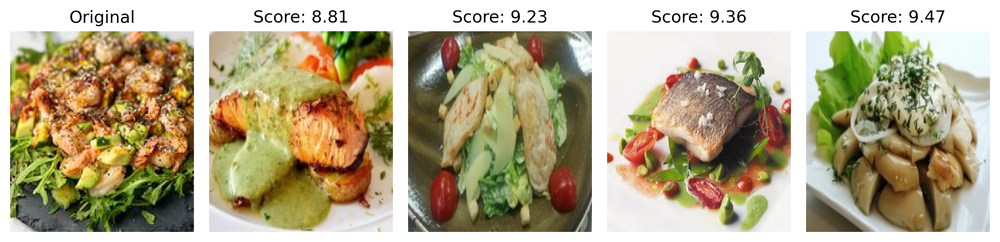

In [54]:
show_by_index(0)

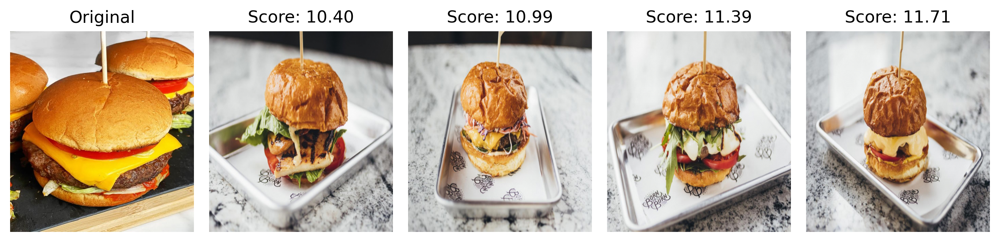

In [55]:
show_by_index(5)

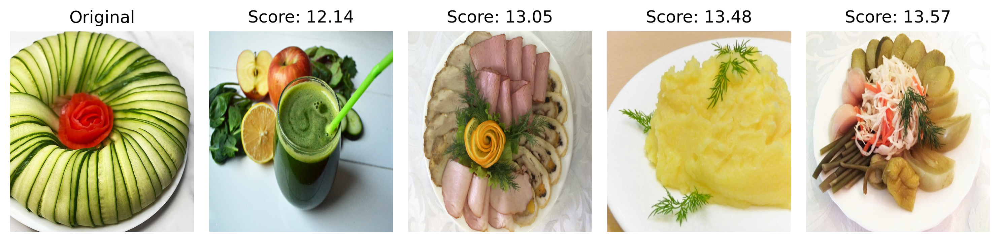

In [56]:
show_by_index(6)

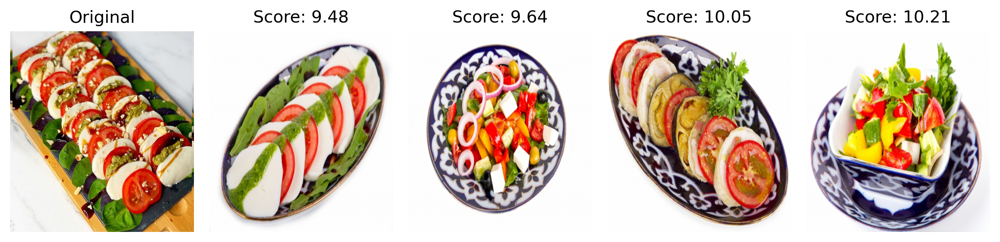

In [57]:
show_by_index(7)

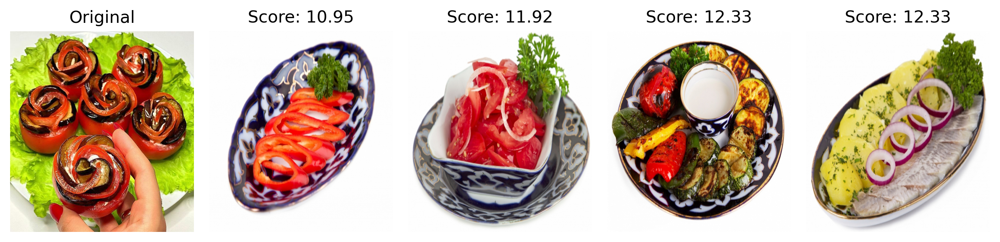

In [58]:
show_by_index(8)

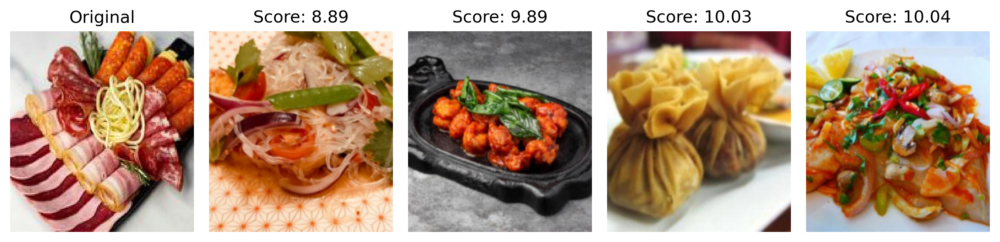

In [61]:
show_by_index(1)

In [65]:
5show_by_index(4)

SyntaxError: invalid syntax (<ipython-input-65-d9eaafe9dbde>, line 1)

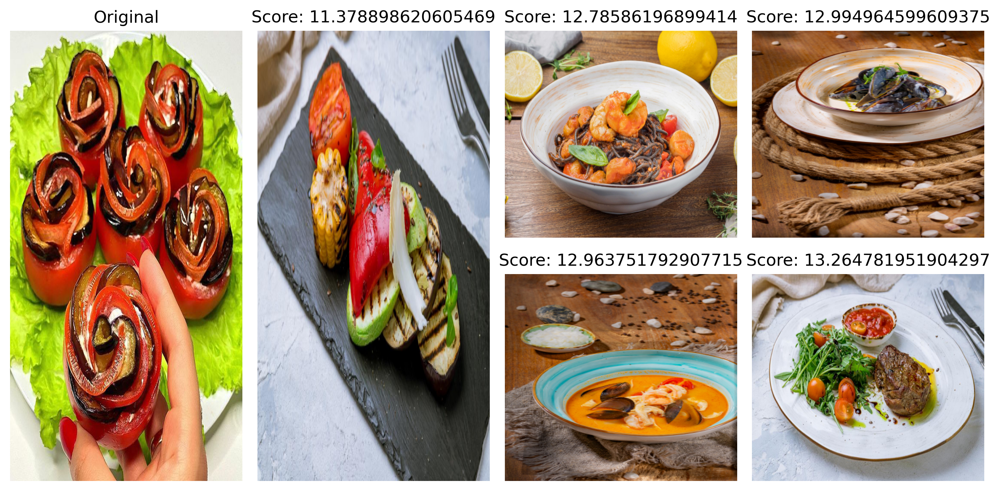

In [72]:
show_by_index(8)

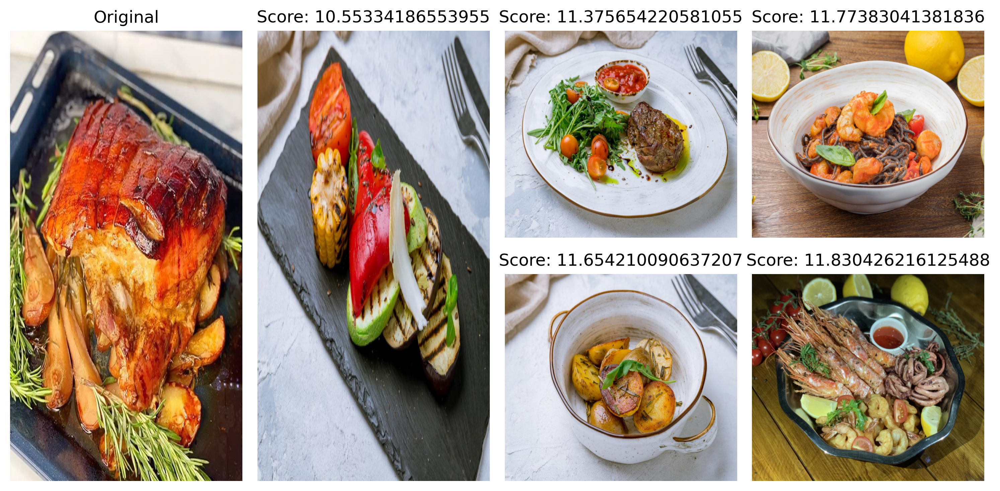

In [73]:
show_by_index(9)